In [ ]:
import torch
import torchvision
import matplotlib.pyplot as plt
from torchvision import transforms
from torch.utils.data import DataLoader
import numpy as np
import torch.nn.functional as F
from torch import nn
import math

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

# Forward Diffusion

## ***This is the closed form equation for computing forward diffusion at any timestep.***

### *Diffusion models scale down the data with each forward process step (by a √ 1 − βt factor) so that variance does not grow when adding noise, thus providing consistently scaled inputs to the neural net reverse process.*


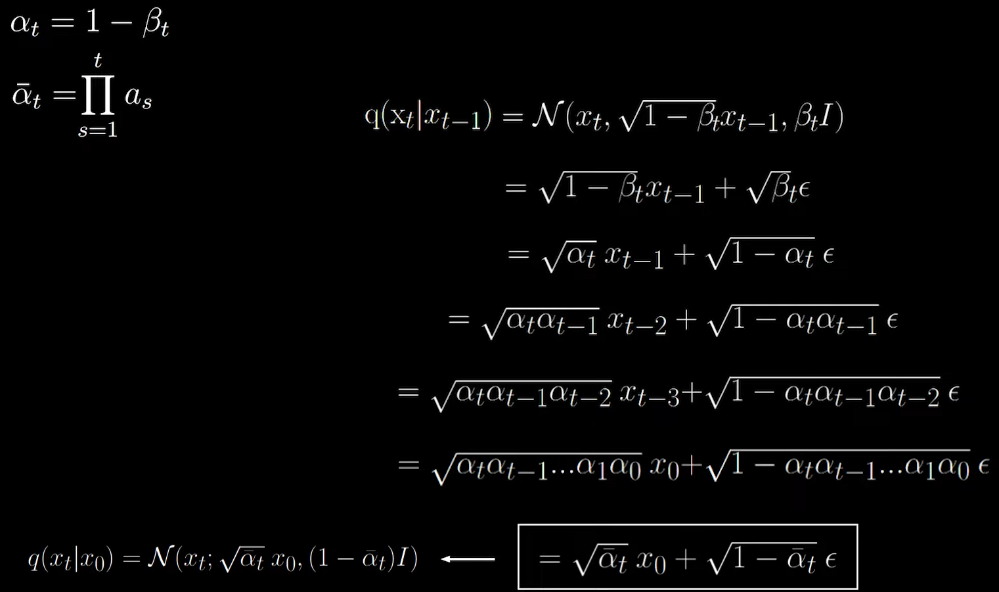

In [ ]:
def linear_scheduler(timesteps, start=0.0001, end=0.02):

    """
    Returns linear schedule for beta
    """
    return torch.linspace(start, end, timesteps)

def get_index_from_list(vals, t, x_shape):

    """
    Returns values from vals for corresponding timesteps
    while considering the batch dimension.

    """
    batch_size = t.shape[0]
    output = vals.gather(-1, t.cpu())
    return output.reshape(batch_size, *((1,) * (len(x_shape) - 1))).to(t.device)

def forward_diffusion_sample(x_0, t, device="cpu"):
    """
    Takes an image and a timestep as input and
    returns the noisy version of it after adding noise t times.
    """
    noise = torch.randn_like(x_0)
    sqrt_alphas_cumprod_t = get_index_from_list(sqrt_alphas_cumprod, t, x_0.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(sqrt_one_minus_alphas_cumprod, t, x_0.shape)

    # mean + variance
    return sqrt_alphas_cumprod_t.to(device) * x_0.to(device) + sqrt_one_minus_alphas_cumprod_t.to(device) * noise.to(device), noise.to(device)


# Define beta schedule
T = 300
betas = linear_scheduler(timesteps=T)

# Pre-calculate different terms for closed form
alphas = 1. - betas
alphas_cumprod = torch.cumprod(alphas, axis=0)
alphas_cumprod_prev = F.pad(alphas_cumprod[:-1], (1, 0), value=1.0)
sqrt_recip_alphas = torch.sqrt(1.0 / alphas)
sqrt_alphas_cumprod = torch.sqrt(alphas_cumprod)
sqrt_one_minus_alphas_cumprod = torch.sqrt(1. - alphas_cumprod)
posterior_variance = betas * (1. - alphas_cumprod_prev) / (1. - alphas_cumprod)

# U-Net Architecture

## ***U-Net Architecture is used to denoise the images and in the process learn the representations.***

![](https://lilianweng.github.io/posts/2021-07-11-diffusion-models/latent-diffusion-arch.png)

In [ ]:
class ConvBlock(nn.Module):
    def __init__(self, in_ch, out_ch, time_emb_dim, up=False):
        super().__init__()

        self.time_mlp =  nn.Linear(time_emb_dim, out_ch)
        if up:
            self.conv1 = nn.Conv2d(2*in_ch, out_ch, 3, padding=1)
            self.transform = nn.ConvTranspose2d(out_ch, out_ch, 4, 2, 1)
        else:
            self.conv1 = nn.Conv2d(in_ch, out_ch, 3, padding=1)
            self.transform = nn.Conv2d(out_ch, out_ch, 4, 2, 1)

        self.conv2 = nn.Conv2d(out_ch, out_ch, 3, padding=1)
        self.bn1 = nn.BatchNorm2d(out_ch)
        self.bn2 = nn.BatchNorm2d(out_ch)
        self.relu  = nn.ReLU()

    def forward(self, x, t, ):


        h = self.bn1(self.relu(self.conv1(x)))
        # Time embedding
        time_emb = self.relu(self.time_mlp(t))
        # Extend last 2 dimensions
        time_emb = time_emb[(..., ) + (None, ) * 2]
        # Add time channel
        h = h + time_emb

        h = self.bn2(self.relu(self.conv2(h)))
        # Down or Upsample
        return self.transform(h)


class PositionalEncoding(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.dim = dim

    def forward(self, time):
        device = time.device
        half_dim = self.dim // 2
        embeds = math.log(10000) / (half_dim - 1)
        embeds = torch.exp(torch.arange(half_dim, device=device) * -embeds)
        embeds = time[:, None] * embeds[None, :]
        embeds = torch.cat((embeds.sin(), embeds.cos()), dim=-1)
        return embeds


class Unet(nn.Module):
    """
    A simplified Unet architecture.
    """
    def __init__(self):
        super().__init__()
        image_channels = 3
        down_channels = (64, 128, 256, 512, 1024)
        up_channels = (1024, 512, 256, 128, 64)
        out_dim = 1
        time_emb_dim = 32

        # Time embedding
        self.time_mlp = nn.Sequential(
                PositionalEncoding(time_emb_dim),
                nn.Linear(time_emb_dim, time_emb_dim),
                nn.ReLU()
            )


        self.conv0 = nn.Conv2d(image_channels, down_channels[0], 3, padding=1)

        # Downsample
        self.downs = nn.ModuleList([ConvBlock(down_channels[i], down_channels[i+1],
                                    time_emb_dim) for i in range(len(down_channels)-1)])
        # Upsample
        self.ups = nn.ModuleList([ConvBlock(up_channels[i], up_channels[i+1],
                                        time_emb_dim, up=True) for i in range(len(up_channels)-1)])

        self.output = nn.Conv2d(up_channels[-1], 3, out_dim)

    def forward(self, x, timestep):

        # Embedd time
        t = self.time_mlp(timestep)
        x = self.conv0(x)

        # Unet
        residual_inputs = []
        for down in self.downs:
            x = down(x, t)
            residual_inputs.append(x)
        for up in self.ups:
            residual_x = residual_inputs.pop()
            x = torch.cat((x, residual_x), dim=1)
            x = up(x, t)
        return self.output(x)

model = Unet()
model

Unet(
  (time_mlp): Sequential(
    (0): PositionalEncoding()
    (1): Linear(in_features=32, out_features=32, bias=True)
    (2): ReLU()
  )
  (conv0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (downs): ModuleList(
    (0): ConvBlock(
      (time_mlp): Linear(in_features=32, out_features=128, bias=True)
      (conv1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (transform): Conv2d(128, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU()
    )
    (1): ConvBlock(
      (time_mlp): Linear(in_features=32, out_features=256, bias=True)
      (conv1): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (transform): Conv2d(256

# Loss

## ***After some math heavy processes, we arrive at a simple loss function for training.***

![](https://lilianweng.github.io/posts/2021-07-11-diffusion-models/DDPM-algo.png)

In [ ]:
def get_loss(model, x_0, t):
    x_noisy, noise = forward_diffusion_sample(x_0, t, device)
    noise_pred = model(x_noisy, t)
    return F.l1_loss(noise, noise_pred)

In [ ]:
@torch.no_grad()
def sample_timestep(x, t):
    """
    Calls the model to predict the noise in the image and returns
    the denoised image.
    """
    betas_t = get_index_from_list(betas, t, x.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(
        sqrt_one_minus_alphas_cumprod, t, x.shape
    )
    sqrt_recip_alphas_t = get_index_from_list(sqrt_recip_alphas, t, x.shape)

    # Call model (current image - noise prediction)
    model_mean = sqrt_recip_alphas_t * (
        x - betas_t * model(x, t) / sqrt_one_minus_alphas_cumprod_t
    )
    posterior_variance_t = get_index_from_list(posterior_variance, t, x.shape)

    if t == 0:
        return model_mean
    else:
        noise = torch.randn_like(x)
        return model_mean + torch.sqrt(posterior_variance_t) * noise

@torch.no_grad()
def sample_plot_image():
    # Sample noise
    img_size = IMG_SIZE
    img = torch.randn((1, 3, img_size, img_size), device=device)
    plt.figure(figsize=(15,15))
    plt.axis('off')
    num_images = 10
    stepsize = int(T//num_images)

    for i in range(0,T)[::-1]:
        t = torch.full((1,), i, device=device, dtype=torch.long)
        img = sample_timestep(img, t)
        if i % stepsize == 0:
            plt.subplot(1, num_images, i//stepsize+1)
            show_tensor_image(img.detach().cpu())
    plt.show()

# Dataset

In [ ]:
data = torchvision.datasets.FashionMNIST(root=".", download=True)

In [ ]:
data.data.shape

torch.Size([60000, 28, 28])

In [ ]:
def show_images(datset, num_samples=20, cols=4):
    """ Plots some samples from the dataset """
    plt.figure(figsize=(28,28))
    for i, img in enumerate(data):
        print(img[0])
        if i == num_samples:
            break
        plt.subplot(num_samples//cols + 1, cols, i + 1)
        plt.imshow(img[0])

<PIL.Image.Image image mode=L size=28x28 at 0x7D5292BE5360>
<PIL.Image.Image image mode=L size=28x28 at 0x7D5292BE6260>
<PIL.Image.Image image mode=L size=28x28 at 0x7D528F9417B0>
<PIL.Image.Image image mode=L size=28x28 at 0x7D528F960130>
<PIL.Image.Image image mode=L size=28x28 at 0x7D528F908C70>
<PIL.Image.Image image mode=L size=28x28 at 0x7D528F8BC8E0>
<PIL.Image.Image image mode=L size=28x28 at 0x7D528F8A3FD0>
<PIL.Image.Image image mode=L size=28x28 at 0x7D5291BFCEB0>
<PIL.Image.Image image mode=L size=28x28 at 0x7D528FA430A0>
<PIL.Image.Image image mode=L size=28x28 at 0x7D528FA212D0>
<PIL.Image.Image image mode=L size=28x28 at 0x7D528FA04AC0>
<PIL.Image.Image image mode=L size=28x28 at 0x7D5291D39ED0>
<PIL.Image.Image image mode=L size=28x28 at 0x7D528F9B61A0>
<PIL.Image.Image image mode=L size=28x28 at 0x7D5291CDB790>
<PIL.Image.Image image mode=L size=28x28 at 0x7D528F993C70>
<PIL.Image.Image image mode=L size=28x28 at 0x7D52919663B0>
<PIL.Image.Image image mode=L size=28x28

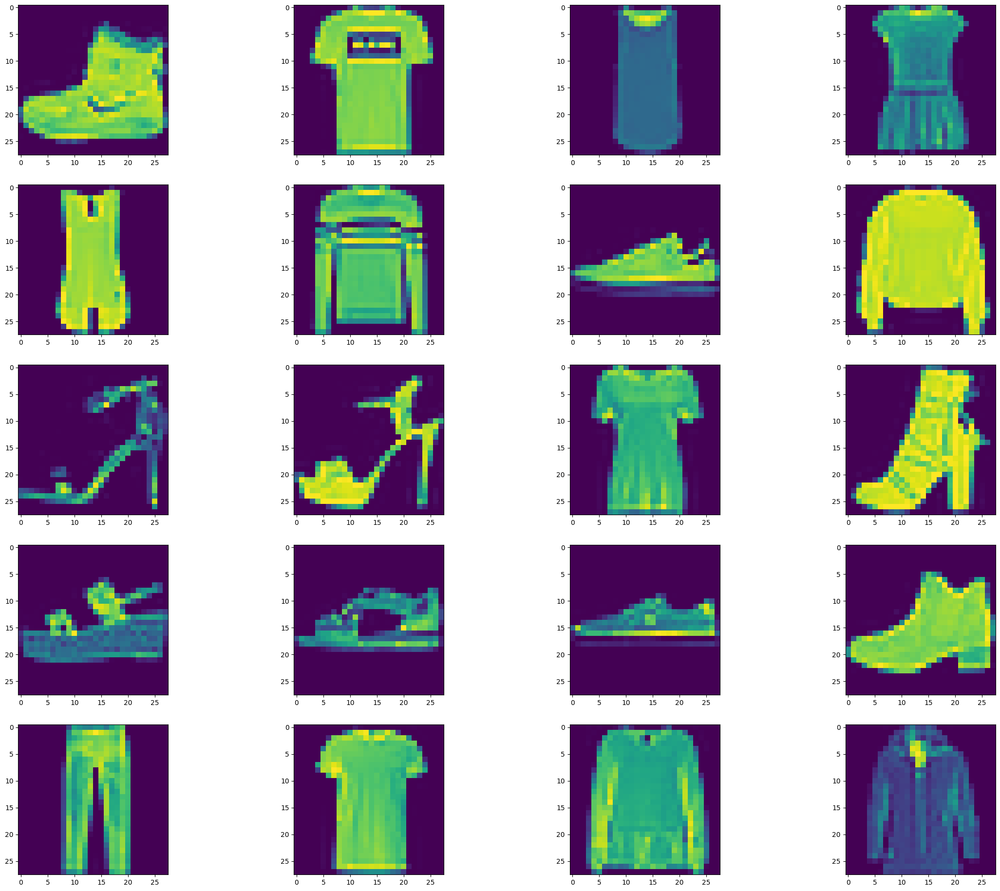

In [ ]:
show_images(data)

In [ ]:
IMG_SIZE = 64
BATCH_SIZE = 128

from torch.utils.data import Subset

NUM_IMAGES_TO_KEEP = 1800

NUM_IMAGES_TO_KEEP_test = 100

def load_transformed_dataset():
    '''
    Returns data after applying appropriate transformations,
    to work with diffusion models.
    '''
    data_transforms = [
        transforms.Resize((IMG_SIZE, IMG_SIZE)),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(), # Scales data into [0,1]
        transforms.Lambda(lambda t: (t * 2) - 1) # Scale between [-1, 1]
    ]
    data_transform = transforms.Compose(data_transforms)

    train = torchvision.datasets.FashionMNIST(root=".", download=True,
                                         transform=data_transform , train=True)
    test = torchvision.datasets.FashionMNIST(root=".", download=True,
                                         transform=data_transform, train = False)


    subset_indices = list(range(NUM_IMAGES_TO_KEEP))
    subset_train_dataset = Subset(train, subset_indices)


    subset_indices_test = list(range(NUM_IMAGES_TO_KEEP_test))
    subset_test_dataset = Subset(test, subset_indices_test)

    return torch.utils.data.ConcatDataset([subset_train_dataset, subset_test_dataset])

def show_tensor_image(image):

    '''
    Plots image after applying reverse transformations.
    '''

    reverse_transforms = transforms.Compose([
        transforms.Lambda(lambda t: (t + 1) / 2),
        transforms.Lambda(lambda t: t.permute(1, 2, 0)), # CHW to HWC
        transforms.Lambda(lambda t: t * 255.),
        transforms.Lambda(lambda t: t.numpy().astype(np.uint8)),
        transforms.ToPILImage(),
    ])


    if len(image.shape) == 4:
        image = image[0, :, :, :]
    plt.imshow(reverse_transforms(image))

data = load_transformed_dataset()
dataloader = DataLoader(data, batch_size=BATCH_SIZE, shuffle=True, drop_last=True)

### ***Sample Forward Diffusion***

<ipython-input-36-3b523e3dabf4>:10: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1, num_images+1, (idx//stepsize) + 1)


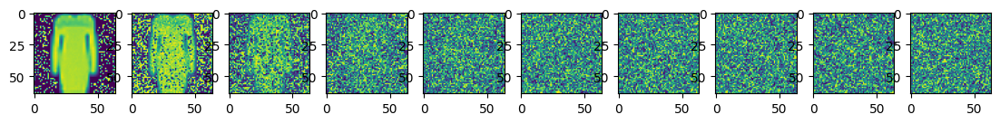

In [ ]:
image = next(iter(dataloader))[0]

plt.figure(figsize=(15,15))
plt.axis('off')
num_images = 10
stepsize = int(T/num_images)

for idx in range(0, T, stepsize):
    t = torch.Tensor([idx]).type(torch.int64)
    plt.subplot(1, num_images+1, (idx//stepsize) + 1)
    image, noise = forward_diffusion_sample(image, t)
    show_tensor_image(image)

### ***We can see that the noise being applied at every timestep is too aggresive and image quickly converges to pure noise.***

### ***Many researchers then used different types of beta scheduling other than the linear one we have used, like for example a cosine schedule which adds noise more gradually.***

# Training

In [ ]:
from torch.optim import Adam

In [ ]:
model.to(device)
optimizer = Adam(model.parameters(), lr=3e-4)
epochs = 100

for epoch in range(epochs):
    for step, batch in enumerate(dataloader):
      optimizer.zero_grad()

      t = torch.randint(0, T, (BATCH_SIZE,), device=device).long()
      loss = get_loss(model, batch[0], t)
      loss.backward()
      optimizer.step()

      if epoch % 5 == 0 and step == 0:
        print(f"Epoch {epoch} | step {step:03d} Loss: {loss.item()} ")
        sample_plot_image()

RuntimeError: ignored

Epoch 0 | step 000 Loss: 0.8099091053009033 


<ipython-input-30-0abe4140ebbe>:39: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1, num_images, i//stepsize+1)


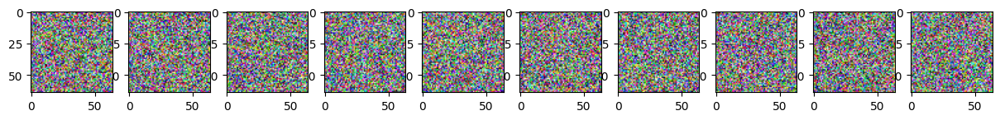

Epoch 5 | step 000 Loss: 0.24409949779510498 


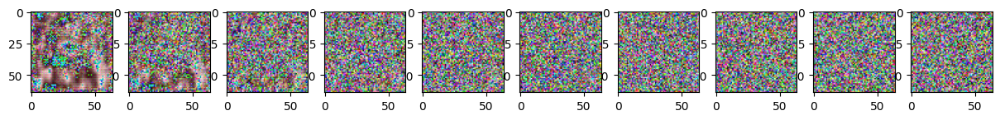

Epoch 10 | step 000 Loss: 0.22994594275951385 


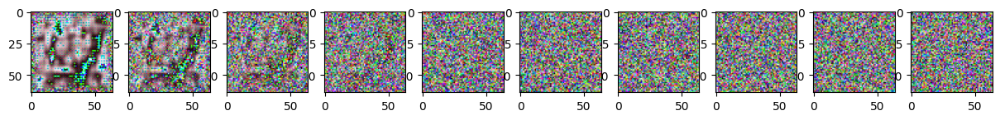

Epoch 15 | step 000 Loss: 0.18548747897148132 


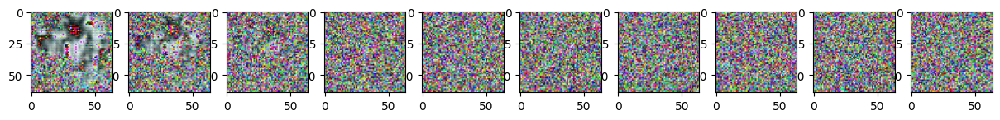

Epoch 20 | step 000 Loss: 0.17608635127544403 


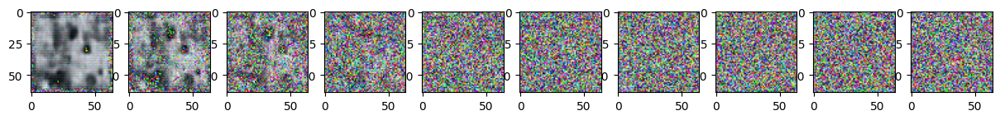

Epoch 25 | step 000 Loss: 0.14498671889305115 


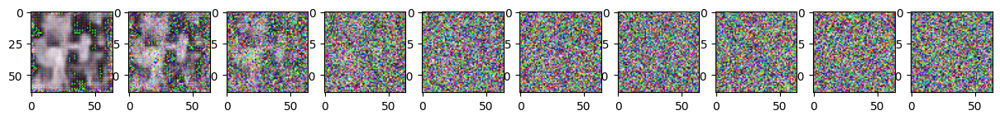

Epoch 30 | step 000 Loss: 0.15673594176769257 


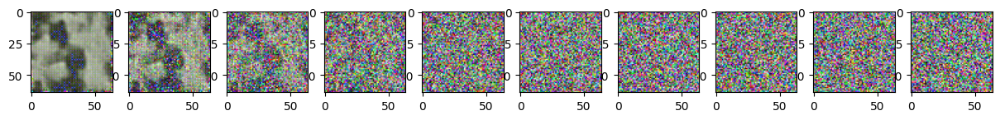

Epoch 35 | step 000 Loss: 0.12110667675733566 


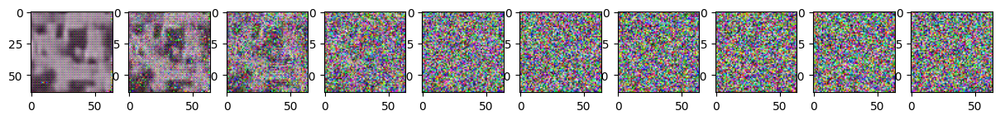

Epoch 40 | step 000 Loss: 0.11641578376293182 


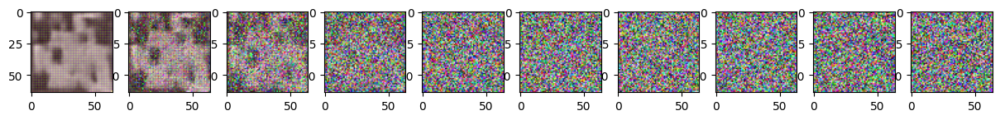

Epoch 45 | step 000 Loss: 0.1152786836028099 


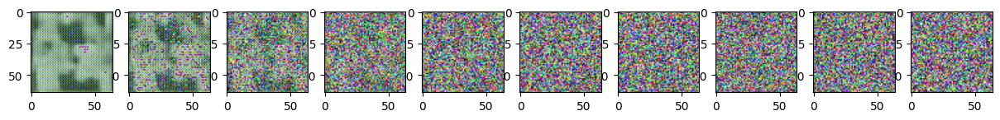

Epoch 50 | step 000 Loss: 0.11174481362104416 


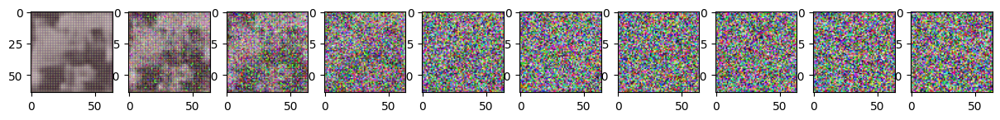

Epoch 55 | step 000 Loss: 0.10551652312278748 


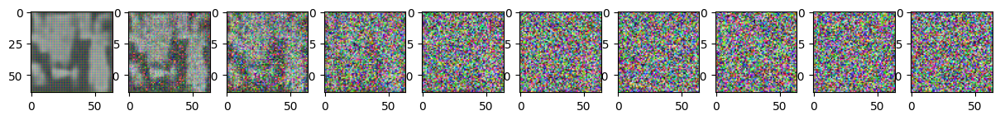

Epoch 60 | step 000 Loss: 0.10054895281791687 


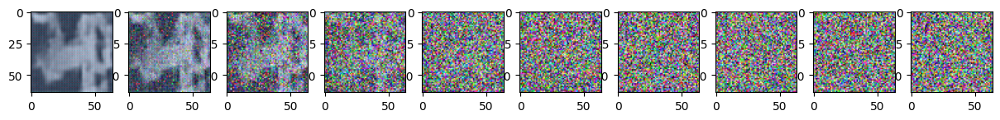

Epoch 65 | step 000 Loss: 0.12255962938070297 


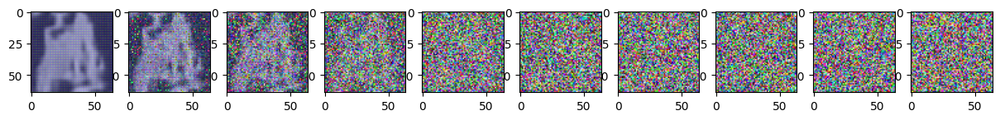

Epoch 70 | step 000 Loss: 0.09138672053813934 


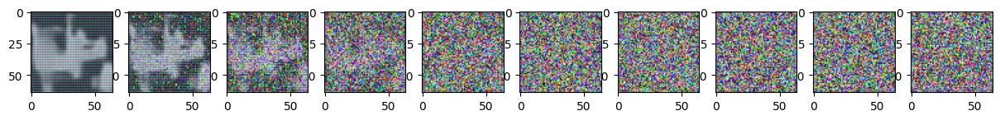

Epoch 75 | step 000 Loss: 0.09455394744873047 


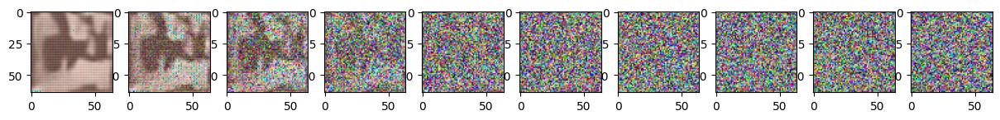

Epoch 80 | step 000 Loss: 0.08661109209060669 


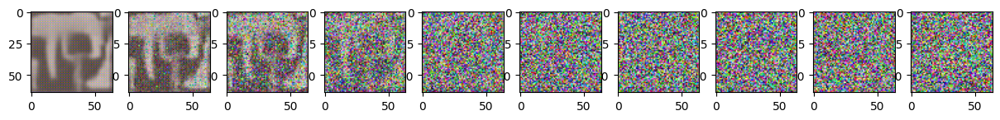

Epoch 85 | step 000 Loss: 0.09773945063352585 


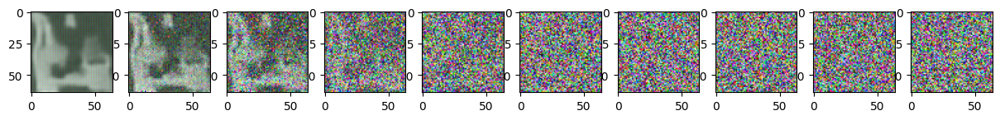

Epoch 90 | step 000 Loss: 0.08112850785255432 


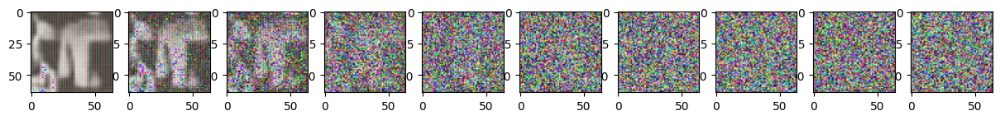

Epoch 95 | step 000 Loss: 0.08085109293460846 


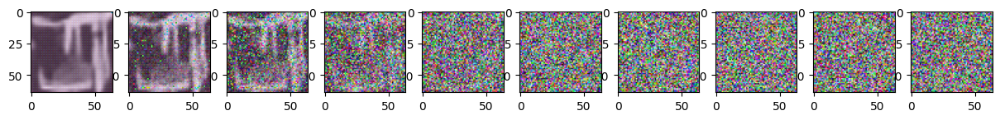

Epoch 100 | step 000 Loss: 0.08484403789043427 


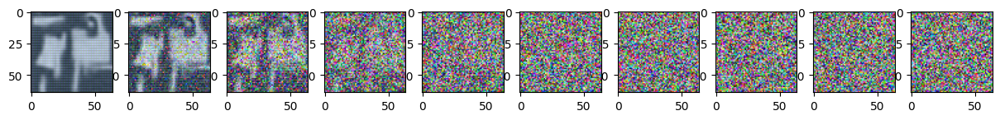

Epoch 105 | step 000 Loss: 0.08968733996152878 


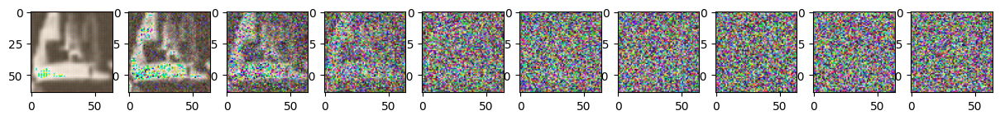

Epoch 110 | step 000 Loss: 0.0851946696639061 


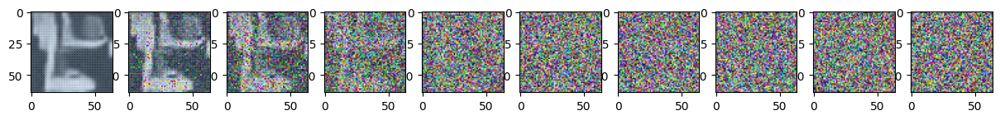

Epoch 115 | step 000 Loss: 0.08587660640478134 


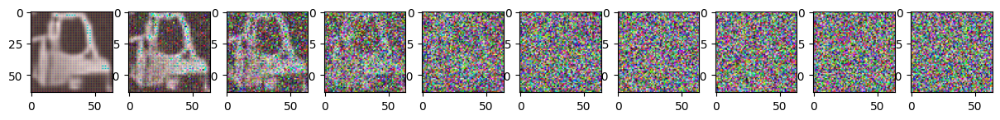

Epoch 120 | step 000 Loss: 0.07077764719724655 


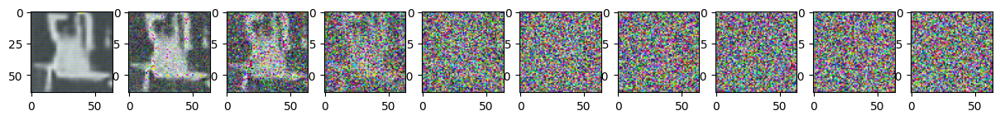

Epoch 125 | step 000 Loss: 0.0725826621055603 


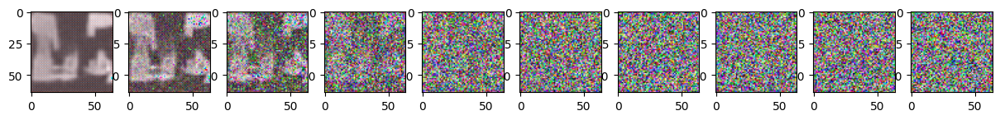

Epoch 130 | step 000 Loss: 0.07946081459522247 


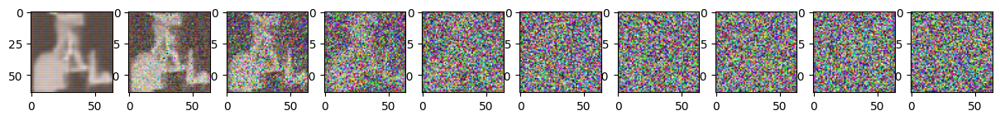

Epoch 135 | step 000 Loss: 0.07082545757293701 


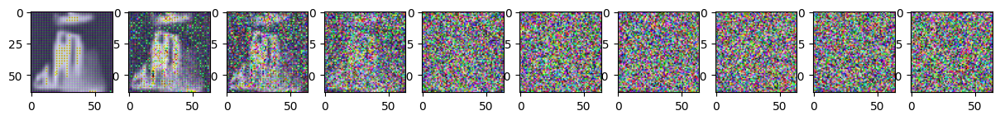

Epoch 140 | step 000 Loss: 0.0761907771229744 


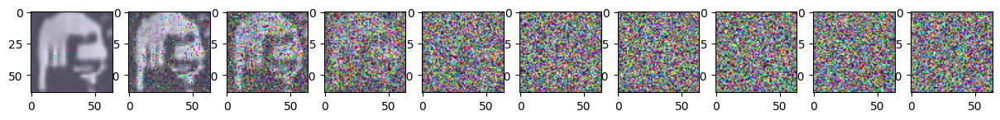

Epoch 145 | step 000 Loss: 0.07749765366315842 


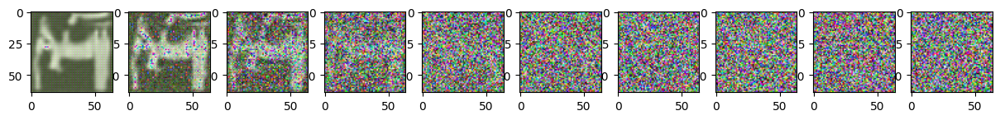

Epoch 150 | step 000 Loss: 0.07805754989385605 


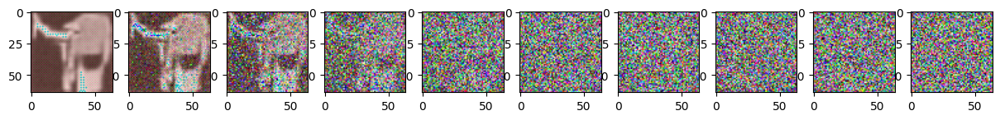

Epoch 155 | step 000 Loss: 0.0759793370962143 


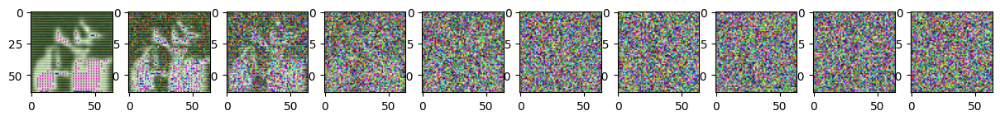

Epoch 160 | step 000 Loss: 0.06747913360595703 


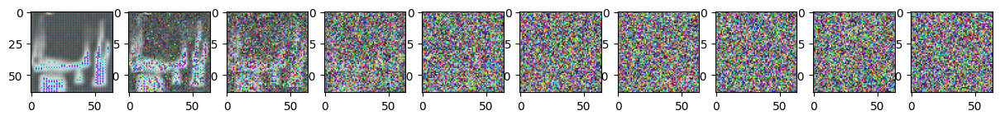

Epoch 165 | step 000 Loss: 0.06458909809589386 


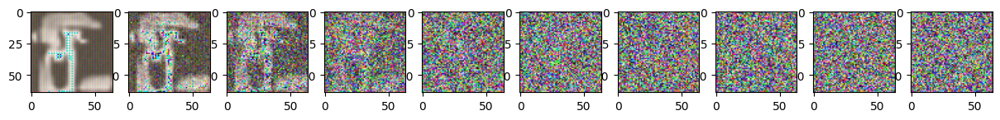

Epoch 170 | step 000 Loss: 0.06735417246818542 


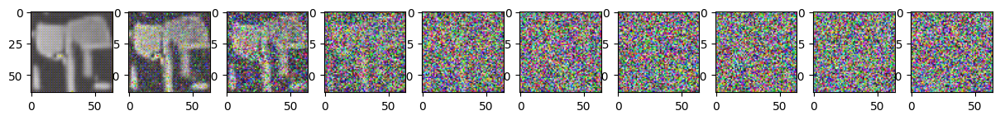

Epoch 175 | step 000 Loss: 0.06654996424913406 


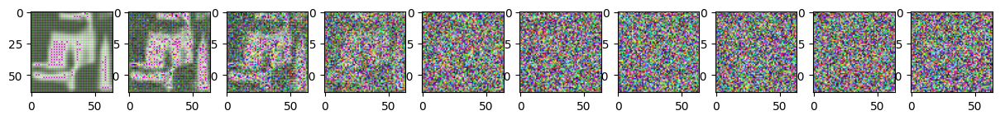

Epoch 180 | step 000 Loss: 0.07466863095760345 


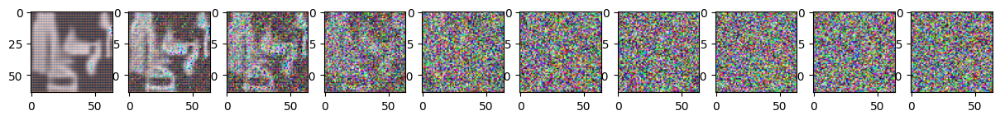

Epoch 185 | step 000 Loss: 0.07167738676071167 


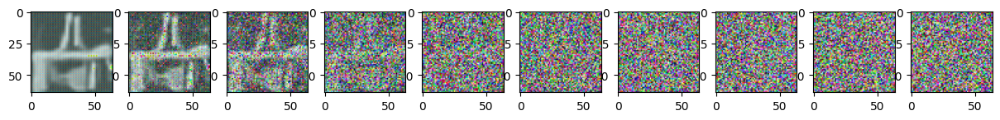

Epoch 190 | step 000 Loss: 0.06685121357440948 


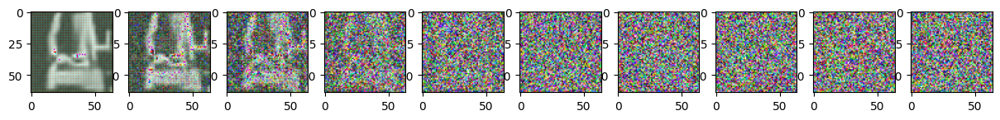

Epoch 195 | step 000 Loss: 0.06739532947540283 


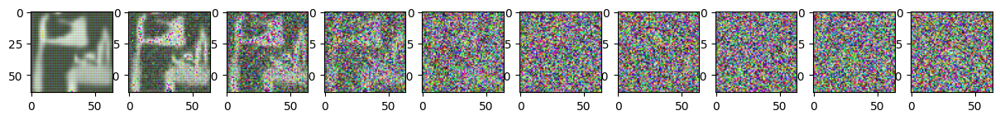

Epoch 200 | step 000 Loss: 0.06945357471704483 


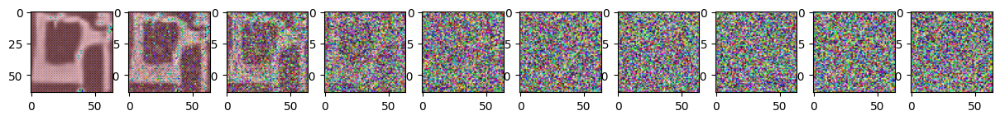

Epoch 205 | step 000 Loss: 0.06063160300254822 


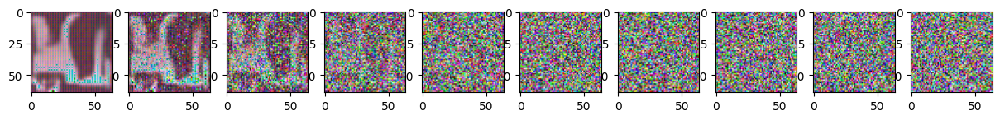

Epoch 210 | step 000 Loss: 0.0666530430316925 


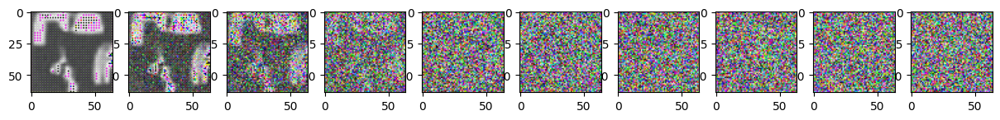

Epoch 215 | step 000 Loss: 0.06337942183017731 


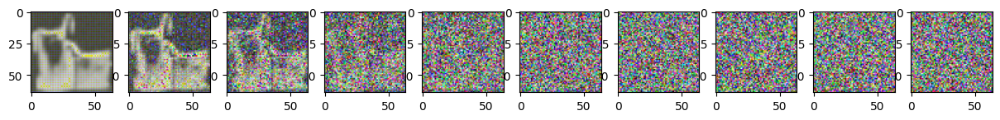

Epoch 220 | step 000 Loss: 0.05848950147628784 


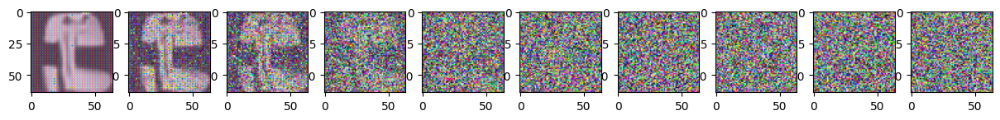

Epoch 225 | step 000 Loss: 0.06222761794924736 


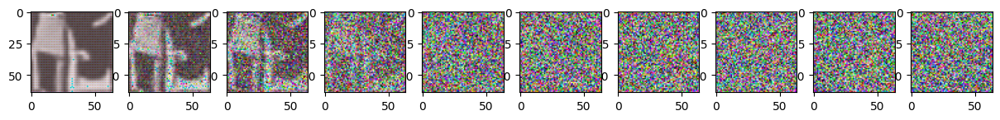

Epoch 230 | step 000 Loss: 0.06730100512504578 


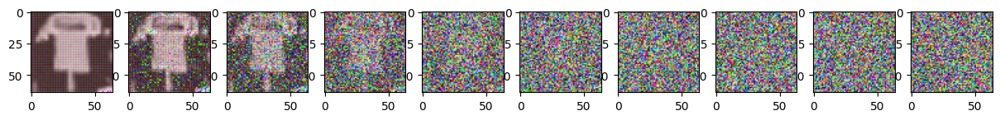

Epoch 235 | step 000 Loss: 0.06385970860719681 


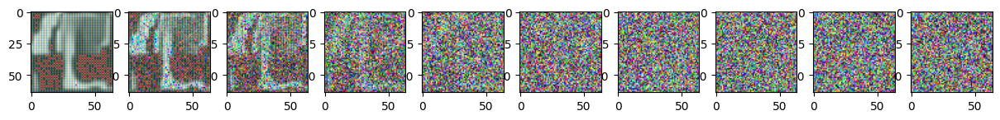

Epoch 240 | step 000 Loss: 0.06839605420827866 


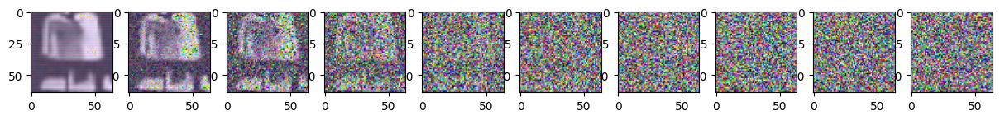

Epoch 245 | step 000 Loss: 0.06019753962755203 


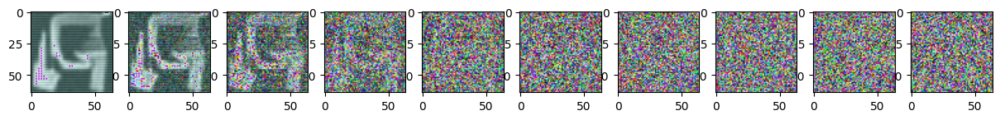

Epoch 250 | step 000 Loss: 0.06970477104187012 


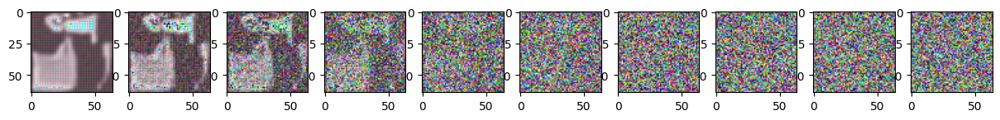

Epoch 255 | step 000 Loss: 0.06063229590654373 


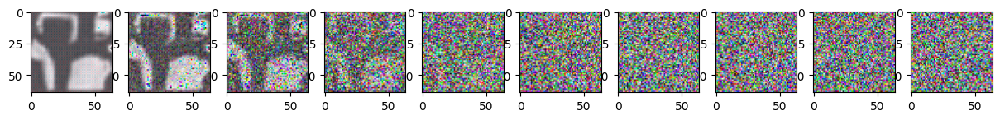

Epoch 260 | step 000 Loss: 0.06731130927801132 


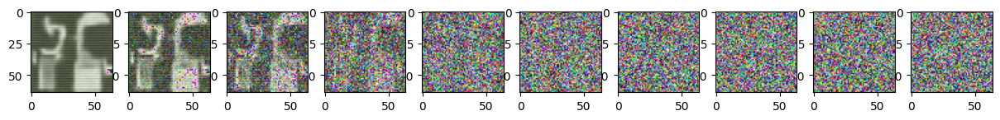

Epoch 265 | step 000 Loss: 0.06602297723293304 


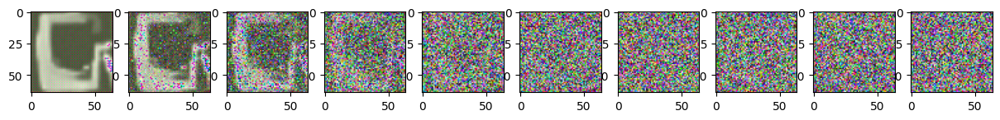

Epoch 270 | step 000 Loss: 0.06421942263841629 


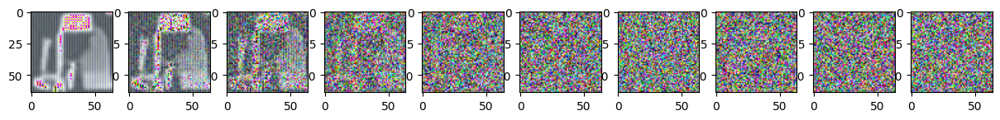

Epoch 275 | step 000 Loss: 0.05673486739397049 


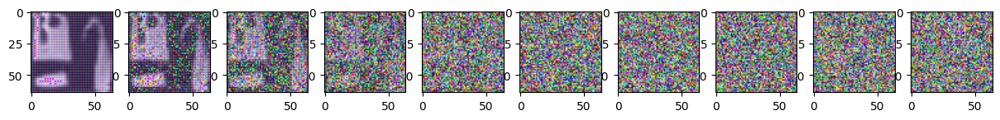

Epoch 280 | step 000 Loss: 0.06427153944969177 


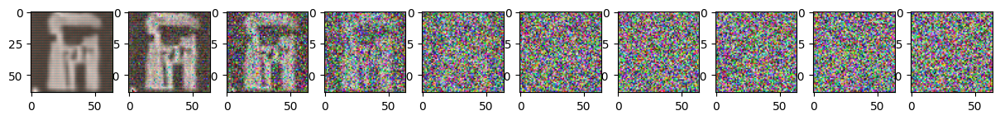

Epoch 285 | step 000 Loss: 0.0680224820971489 


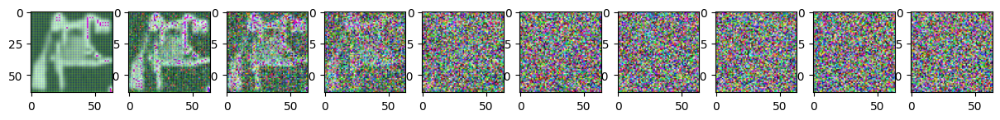

Epoch 290 | step 000 Loss: 0.06803866475820541 


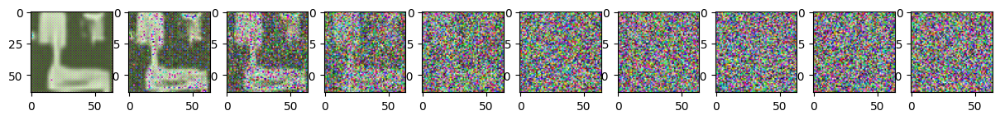

Epoch 295 | step 000 Loss: 0.058554358780384064 


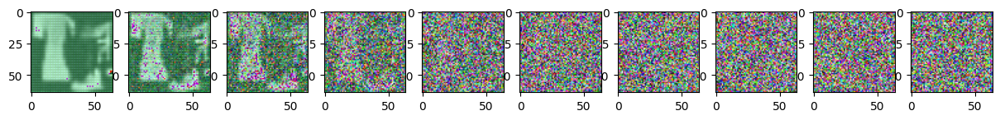

Epoch 300 | step 000 Loss: 0.062476933002471924 


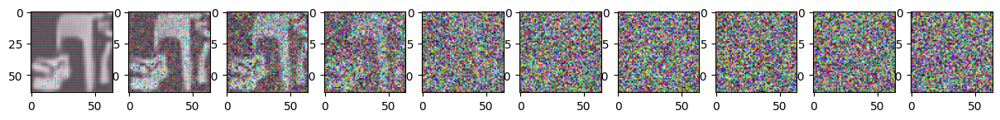

Epoch 305 | step 000 Loss: 0.05664945766329765 


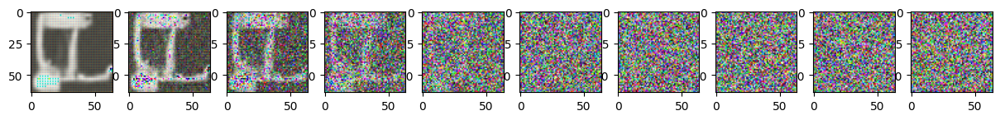

Epoch 310 | step 000 Loss: 0.05895840749144554 


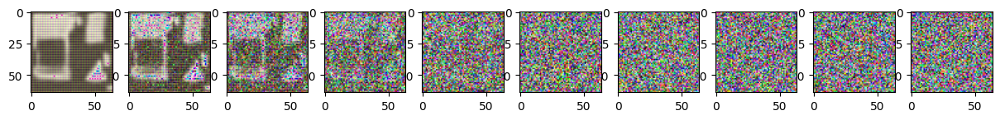

Epoch 315 | step 000 Loss: 0.06206576153635979 


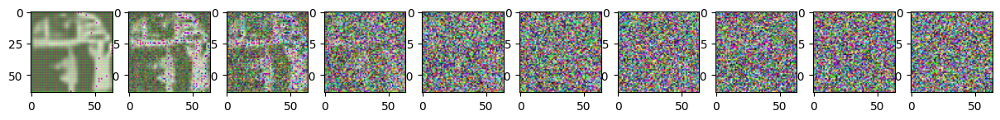

Epoch 320 | step 000 Loss: 0.05776465684175491 


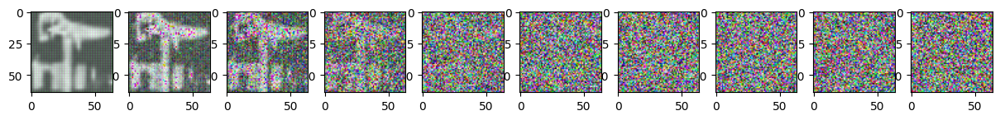

Epoch 325 | step 000 Loss: 0.05541926622390747 


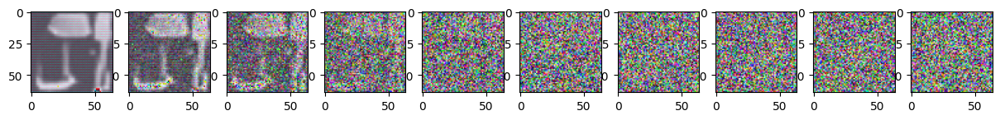

Epoch 330 | step 000 Loss: 0.06685272604227066 


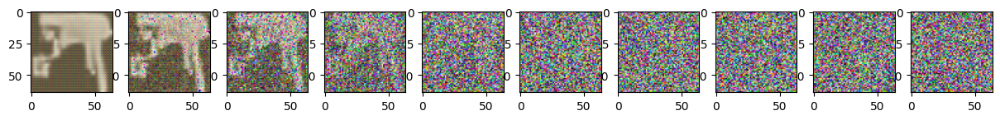

Epoch 335 | step 000 Loss: 0.05467292666435242 


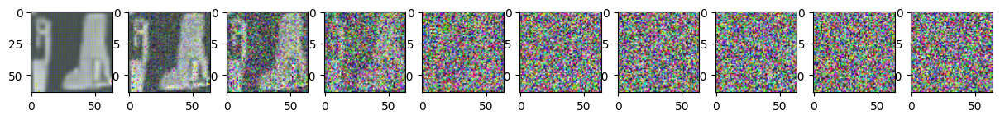

Epoch 340 | step 000 Loss: 0.0548119992017746 


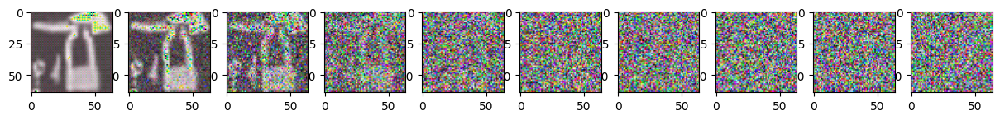

Epoch 345 | step 000 Loss: 0.058509461581707 


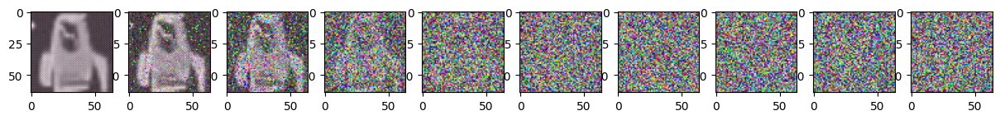

Epoch 350 | step 000 Loss: 0.06641581654548645 


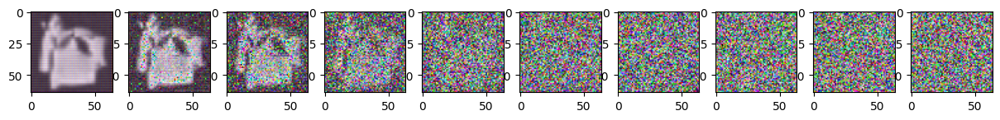

Epoch 355 | step 000 Loss: 0.06671909987926483 


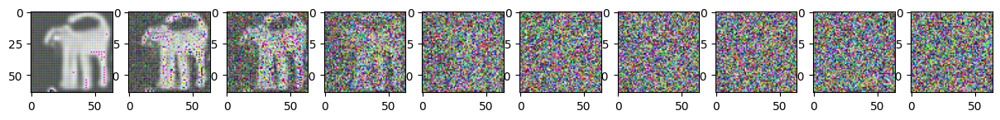

Epoch 360 | step 000 Loss: 0.053788281977176666 


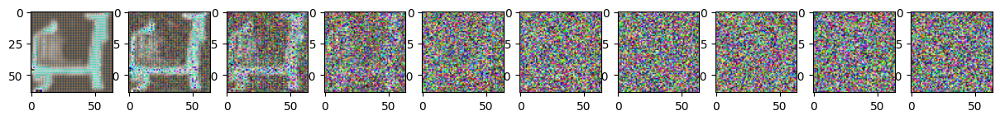

Epoch 365 | step 000 Loss: 0.06015941500663757 


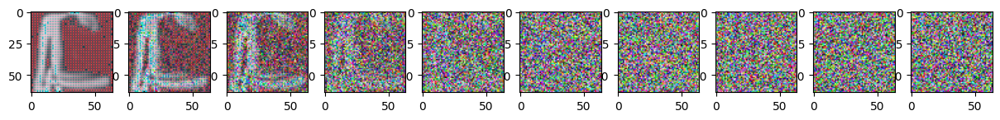

Epoch 370 | step 000 Loss: 0.05465146154165268 


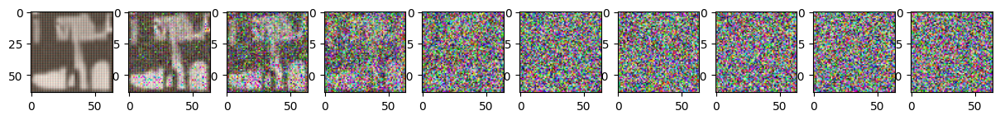

Epoch 375 | step 000 Loss: 0.06191334128379822 


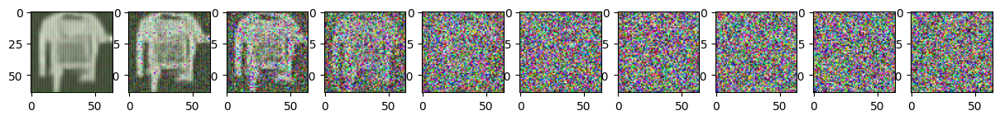

Epoch 380 | step 000 Loss: 0.06222541257739067 


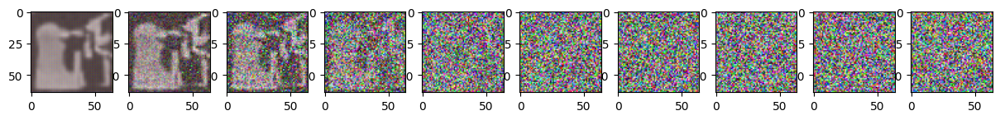

Epoch 385 | step 000 Loss: 0.060512151569128036 


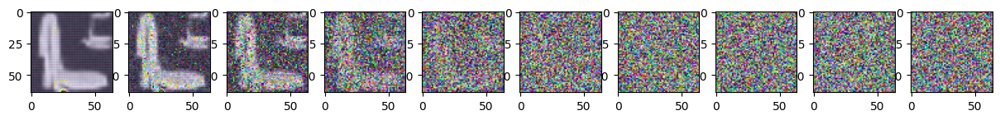

Epoch 390 | step 000 Loss: 0.0541386678814888 


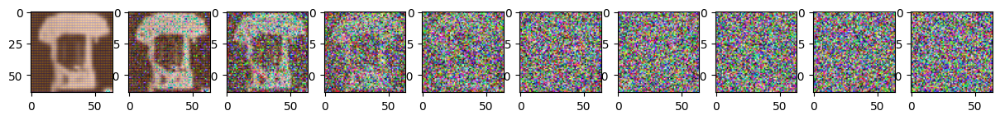

Epoch 395 | step 000 Loss: 0.05289227515459061 


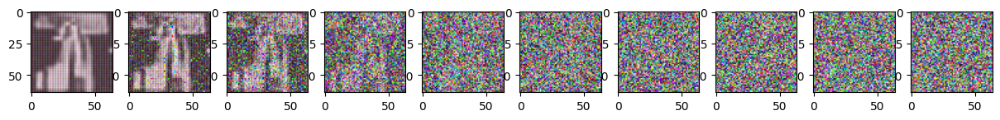

Epoch 400 | step 000 Loss: 0.05804675817489624 


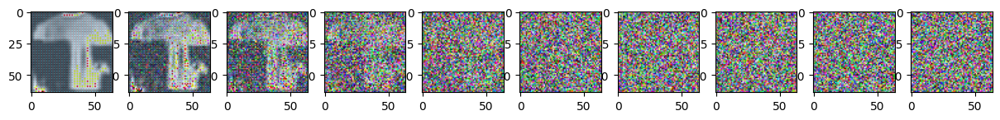

Epoch 405 | step 000 Loss: 0.05318974703550339 


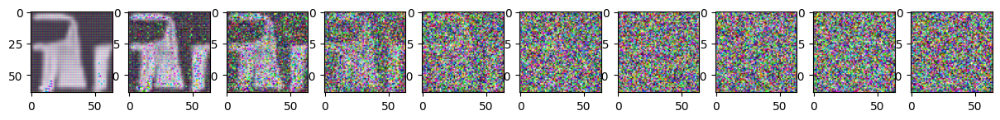

Epoch 410 | step 000 Loss: 0.05532904714345932 


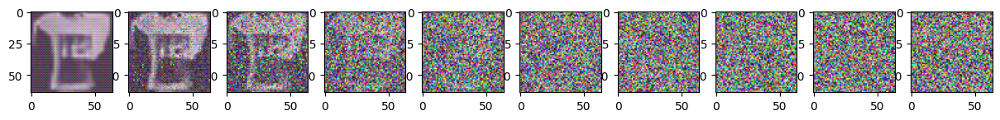

Epoch 415 | step 000 Loss: 0.057855844497680664 


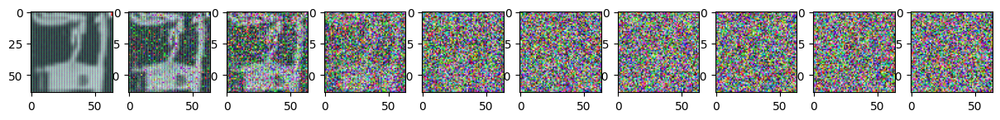

Epoch 420 | step 000 Loss: 0.05333283543586731 


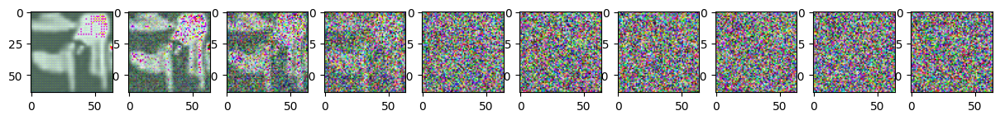

Epoch 425 | step 000 Loss: 0.05677161365747452 


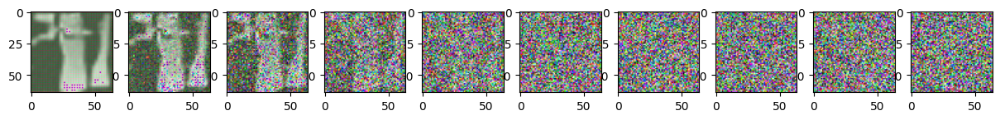

Epoch 430 | step 000 Loss: 0.05542399734258652 


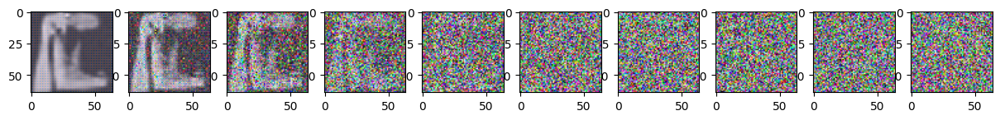

Epoch 435 | step 000 Loss: 0.05794807896018028 


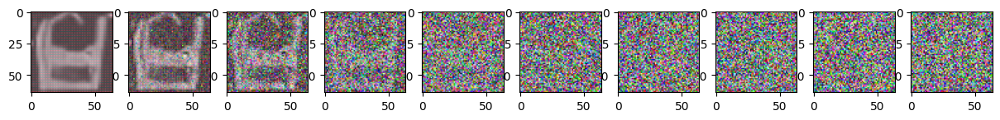

Epoch 440 | step 000 Loss: 0.06247987970709801 


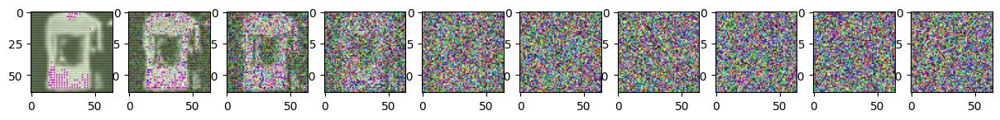

Epoch 445 | step 000 Loss: 0.054728567600250244 


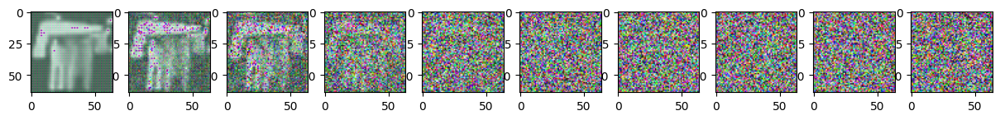

Epoch 450 | step 000 Loss: 0.05169295519590378 


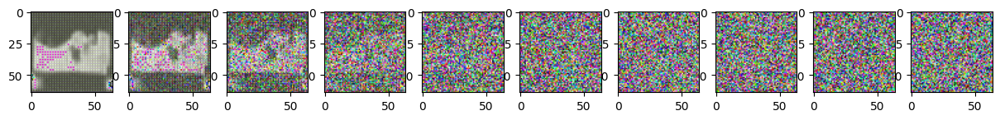

Epoch 455 | step 000 Loss: 0.05417022854089737 


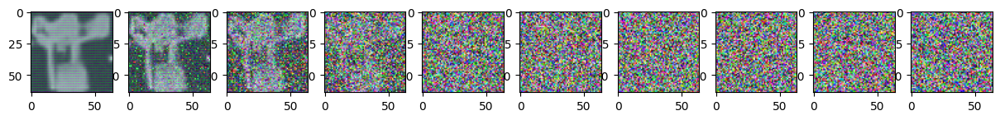

Epoch 460 | step 000 Loss: 0.04937772452831268 


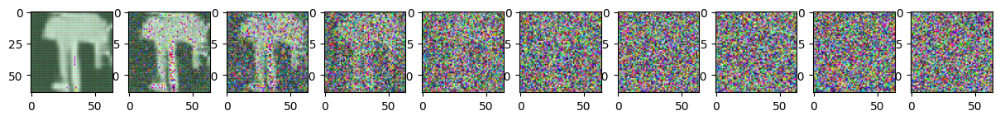

Epoch 465 | step 000 Loss: 0.05295306444168091 


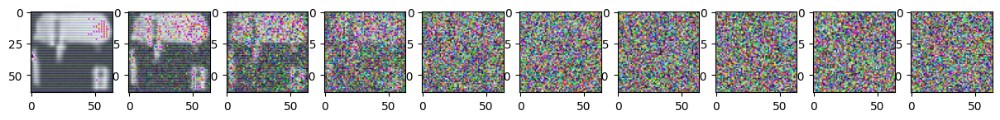

Epoch 470 | step 000 Loss: 0.0575256310403347 


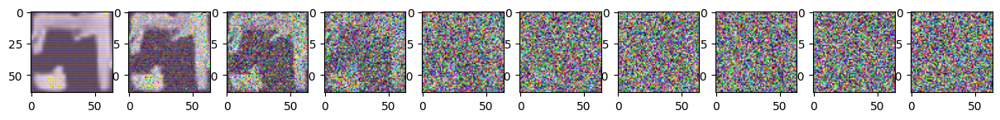

Epoch 475 | step 000 Loss: 0.05232606455683708 


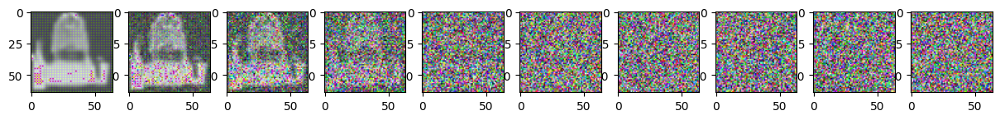

Epoch 480 | step 000 Loss: 0.047896962612867355 


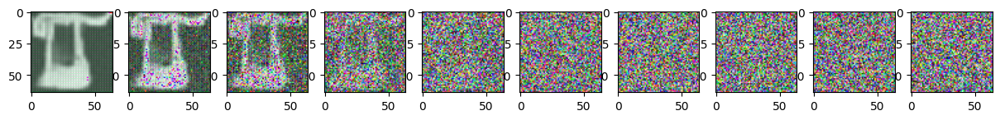

Epoch 485 | step 000 Loss: 0.06305460631847382 


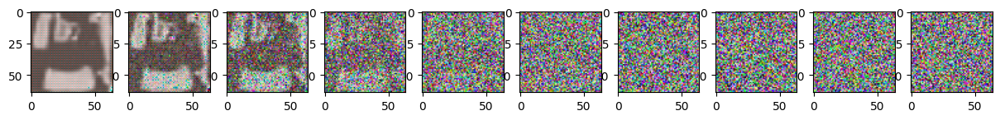

Epoch 490 | step 000 Loss: 0.05542604252696037 


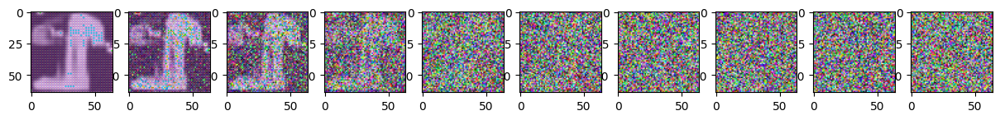

Epoch 495 | step 000 Loss: 0.06180381029844284 


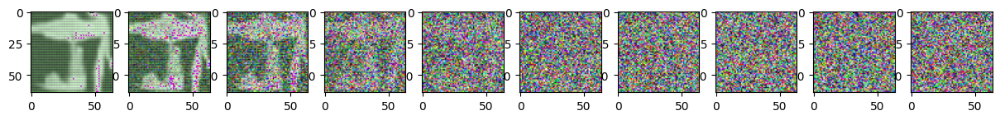

In [ ]:
# Assuming you have grayscale images with shape [batch_size, 1, height, width]
# You can convert them to pseudo-RGB images with shape [batch_size, 3, height, width]
def grayscale_to_rgb(images):
    return torch.cat([images, images, images], dim=1)

model.to(device)
optimizer = Adam(model.parameters(), lr=3e-4)
epochs = 500

for epoch in range(epochs):
    for step, batch in enumerate(dataloader):
        optimizer.zero_grad()

        t = torch.randint(0, T, (BATCH_SIZE,), device=device).long()
        # Convert grayscale images to pseudo-RGB
        input_rgb = grayscale_to_rgb(batch[0])
        loss = get_loss(model, input_rgb, t)
        loss.backward()
        optimizer.step()

        if epoch % 5 == 0 and step == 0:
            print(f"Epoch {epoch} | step {step:03d} Loss: {loss.item()} ")
            sample_plot_image()
        if epoch % 100 == 0 and step == 0:
            torch.save(model, f'./drive/MyDrive/denoising-diffusion-flax/checkpoint/model_{epoch}.pt')
